In [1]:
import pynini
from fst import LexicalFstFactory
import torch
import torchaudio
import matplotlib.pyplot as plt
from typing import *

print(torch.__version__)
print(torchaudio.__version__)

torch.random.manual_seed(0)
device = torch.device("cpu")

print(device)

2.8.0+cu128
2.8.0+cu128
cpu


In [2]:
import requests
from IPython.display import Audio


def play_audio(samples):
    return Audio(samples.data, rate=samples.sample_rate)


# Audio source is CC0: https://opengameart.org/content/town-theme-rpg
# Attribution: cynicmusic.com pixelsphere.org
url = "https://opengameart.org/sites/default/files/TownTheme.mp3"
response = requests.get(url, headers={"User-Agent": ""})
if response.status_code != 200:
    raise RuntimeError(f"Failed to download video. {response.status_code = }.")

raw_audio_bytes = response.content

In [3]:
from torchcodec.decoders import AudioDecoder

decoder = AudioDecoder(raw_audio_bytes)

In [4]:
print(decoder.metadata)

AudioStreamMetadata:
  duration_seconds_from_header: 97.48898
  begin_stream_seconds_from_header: 0.025057
  bit_rate: 108039.0
  codec: mp3
  stream_index: 0
  sample_rate: 44100
  num_channels: 2
  sample_format: fltp



In [5]:
samples = decoder.get_all_samples()

print(samples)
play_audio(samples)

AudioSamples:
  data (shape): torch.Size([2, 4297722])
  pts_seconds: 0.02505668934240363
  duration_seconds: 97.45401360544217
  sample_rate: 44100



In [6]:
bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H
print("Sample Rate:", bundle.sample_rate)
print("Labels:", bundle.get_labels())

Sample Rate: 16000
Labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


In [7]:
model = bundle.get_model().to(device)

print(model.__class__)

<class 'torchaudio.models.wav2vec2.model.Wav2Vec2Model'>


In [8]:
SPEECH_FILE = torchaudio.utils.download_asset("tutorial-assets/Lab41-SRI-VOiCES-src-sp0307-ch127535-sg0042.wav")

/tmp/ipykernel_30402/2363264467.py:1: UserWarning: torchaudio.utils.download.download_asset has been deprecated. This deprecation is part of a large refactoring effort to transition TorchAudio into a maintenance phase. Please see https://github.com/pytorch/audio/issues/3902 for more information. It will be removed from the 2.9 release. 
  SPEECH_FILE = torchaudio.utils.download_asset("tutorial-assets/Lab41-SRI-VOiCES-src-sp0307-ch127535-sg0042.wav")


In [9]:
decoder = AudioDecoder(SPEECH_FILE)
samples = decoder.get_all_samples()

print(samples)
play_audio(samples)

AudioSamples:
  data (shape): torch.Size([1, 54400])
  pts_seconds: 0.0
  duration_seconds: 3.4
  sample_rate: 16000



In [10]:
with torch.inference_mode():
    features, _ = model.extract_features(samples.data)

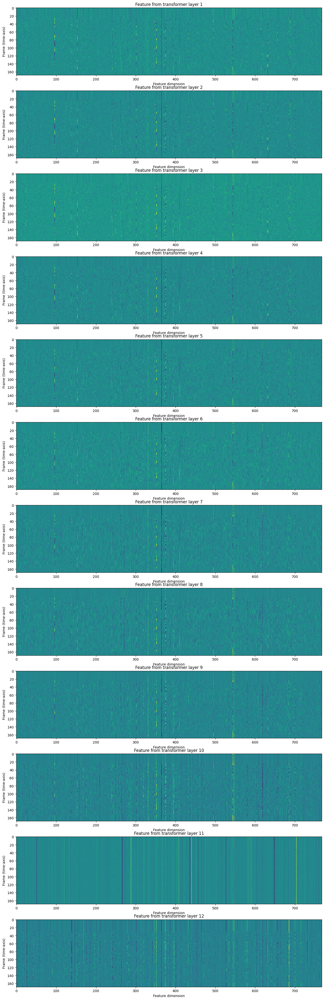

In [11]:
fig, ax = plt.subplots(len(features), 1, figsize=(16, 4.3*len(features)))
for i, feature_vec in enumerate(features):
    ax[i].imshow(feature_vec[0].cpu(), interpolation='nearest')
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")

In [12]:
with torch.inference_mode():
    emission, _ = model(samples.data)

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


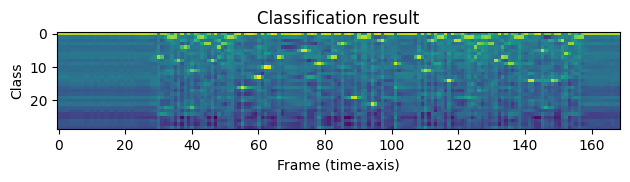

In [13]:
plt.imshow(emission[0].cpu().T, interpolation='nearest')
plt.title("Classification result")
plt.xlabel("Frame (time-axis)")
plt.ylabel("Class")
plt.tight_layout()
print("Class labels:", bundle.get_labels())

In [14]:
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string
        Args:
            emission (Tensor): Logit tensors. Shape `[num_seq, num_label]`.
        returns:
            str: The resulting transcript
        """
        indices = torch.argmax(emission, dim=-1) # [num_seq, ]
        indices_deduplicated = torch.unique_consecutive(indices, dim=-1)
        indices_noblanks = [i for i in indices_deduplicated if i != self.blank]
        decoded_str = "".join(self.labels[i] for i in indices_noblanks)
        return decoded_str
        

In [15]:
decoder = GreedyCTCDecoder(labels=bundle.get_labels())
decoder(emission[0])

'I|HAD|THAT|CURIOSITY|BESIDE|ME|AT|THIS|MOMENT|'

In [16]:
class WFSTDecoder(torch.nn.Module):
    def __init__(
            self,
            labels,
            lexicon: Union[List[str], Dict[str, Union[str, List[str]]]],
            blank=0,
            word_boundary=1,
        ):
        super().__init__()
        if type(lexicon) is list:
            lexicon = WFSTDecoder._lexicon_to_dict(lexicon)

        self.labels = labels
        self.blank = blank
        self.lexicon = lexicon
        self.fst_factory = LexicalFstFactory(
            lexicon=lexicon,
            phonemes=labels,
            blank=labels[blank],
            word_boundary=labels[word_boundary],
        )

    def _lexicon_to_dict(lexicon: List[str]):
        return {word: list(word) for word in lexicon}
    
    def prepare_logits_for_wfst(self, logits: torch.Tensor):
        probs = logits.softmax(dim=-1)
        inverse_probs = 1-probs
        return inverse_probs.numpy()

    def forward(self, emission: torch.Tensor) -> str:
        return self.fst_factory.decode_phone_probabilities(self.prepare_logits_for_wfst(emission))

In [31]:
sentence = 'I|HAD|THAT|QURIOZIDDY|BESEID|ME|AT|THIS|MOMENT|'
words = [word for word in sentence.split(sep='|') if word!='']
decoder = WFSTDecoder(labels=bundle.get_labels(), lexicon=words)

In [32]:
word_decoder = decoder.fst_factory.word_decoder
print_fst = decoder.fst_factory.print_fst
fst_string = decoder.fst_factory.fst_string
fsa = decoder.fst_factory.fsa

In [33]:
decoder(emission[0])

'I HAD THAT QURIOZIDDY BESEID ME AT THIS MOMENT'

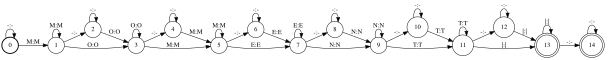

In [20]:
print_fst(decoder.fst_factory.phoneme_fsa("M O M E N T"))

In [22]:
# emission_fsa = fsa('- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - I - - | | - H - A - D - | | T T H - A T T | | - - C - - - - U - R R - - I - - - - - - O O - - - S - - - I - - T - - Y Y | | | - B - - E - - - S - - - - - - I - D - E - | | - M - E E - | | | A T | | T T H - I - S S | | | - M M - - O - - M - - E N T T | | | - - - - - - - - - - -')
emission_fsa = fsa('I | H A D |')
fst_string(emission_fsa@word_decoder)

'I HAD'

In [24]:
phone_prob_fsa = decoder.fst_factory.make_phone_probabilities(decoder.prepare_logits_for_wfst(emission[0]))
decoder.fst_factory.get_top_string(phone_prob_fsa)

'- - - - - - - - - - - - - - - - - - - - - - - - - - - - - - I - - | | - H - A - D - | | T T H - A T T | | - - C - - - - U - R R - - I - - - - - - O O - - - S - - - I - - T - - Y Y | | | - B - - E - - - S - - - - - - I - D - E - | | - M - E E - | | | A T | | T T H - I - S S | | | - M M - - O - - M - - E N T T | | | - - - - - - - - - - -'